### Provide by

นายธนชาติ เสถียรจารุการ 63340500021 <br>

นายธีรดนย์ ฉายโชตืเจริญ 63340500027 <br>

นายพชพล เพชรรัตน์ 63340500036 <br>



In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler, QuantileTransformer
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import silhouette_score
from joblib import load

RandomState = 1

### Setting up for exploration

##### End Match data

- match data

In [2]:
match_df = pd.read_csv('match.csv')
match_df = match_df.drop(['start_time','game_mode', 'negative_votes', 'positive_votes', 'cluster'], axis=1)
match_df['radiant_win'] = match_df['radiant_win'].replace([False, True], [0, 1])
match_df.head()

,match_id,duration,tower_status_radiant,tower_status_dire,barracks_status_dire,barracks_status_radiant,first_blood_time,radiant_win
0,0,2375,1982,4,3,63,1,1
1,1,2582,0,1846,63,0,221,0
2,2,2716,256,1972,63,48,190,0
3,3,3085,4,1924,51,3,40,0
4,4,1887,2047,0,0,63,58,1


- player statistic in any match

In [4]:
player_df = pd.read_csv('players.csv')
player_df = player_df.iloc[:, 0:25]
player_df = player_df.drop(['gold', 'account_id', 'item_0', 'item_1', 'item_2', 'item_3', 'item_4', 'item_5'], axis=1)
player_df['stuns'] = player_df['stuns'].replace(['None'], [0.0])
player_df['stuns'] = player_df['stuns'].astype(np.float64)
player_df['leaver_status'] = player_df['leaver_status'].replace(list(range(5)), [0, 0, 1, 1, 1])
player_df.head()

,match_id,hero_id,player_slot,gold_spent,gold_per_min,xp_per_min,kills,deaths,assists,denies,last_hits,stuns,hero_damage,hero_healing,tower_damage,level,leaver_status
0,0,86,0,10960,347,362,9,3,18,1,30,76.7356,8690,218,143,16,0
1,0,51,1,17760,494,659,13,3,18,9,109,87.4164,23747,0,423,22,0
2,0,83,2,12195,350,385,0,4,15,1,58,0.0000,4217,1595,399,17,0
3,0,11,3,22505,599,605,8,4,19,6,271,0.0000,14832,2714,6055,21,0
4,0,67,4,23825,613,762,20,3,17,13,245,0.0000,33740,243,1833,24,0


- sum of feature values of each team

In [ ]:
cols = list(player_df.columns)
cols = [i for i in cols if i!='match_id' and i!='hero_id' and i!='player_slot']
sum_data = {}
index = []
for j in cols:
    sum_data.update({'radiant_total_'+str(j):[],
                        'dire_total_'+str(j):[]})
for i in tqdm(range(match_df.shape[0])):
    a = player_df.loc[player_df['match_id']==i]
    radiant = a.loc[a['player_slot']<=4]
    dire = a.loc[a['player_slot']>4]
    index.append(i)
    for j in cols:
        sum_data['radiant_total_'+str(j)].append(radiant[j].sum())
        sum_data['dire_total_'+str(j)].append(dire[j].sum())

##### create new dataframe and export
new_df = pd.concat([match_df, pd.DataFrame(data=sum_data, index=index)], axis=1)
# new_df.to_csv("new_match_df.csv")

- what is the most hero picked?
    - most pick is zeus
    - less pick is anti-mage

In [5]:
print(player_df['hero_id'].value_counts())

21     20881
11     17007
74     11676
7      11323
28     11181
       ...  
80       967
78       931
103      838
66       579
0         37
Name: hero_id, Length: 111, dtype: int64


##### Time dependent data

- team fight time

In [6]:
teamfight_time_df = pd.read_csv('teamfights.csv')
teamfight_time_df.head()

,match_id,start,end,last_death,deaths
0,0,220,252,237,3
1,0,429,475,460,3
2,0,900,936,921,3
3,0,1284,1328,1313,3
4,0,1614,1666,1651,5


- player statistic in team fight

In [7]:
teamfight_player_df = pd.read_csv('teamfights_players.csv')
teamfight_player_df = teamfight_player_df.rename(columns={'gold_delta': 'delta_gold'})
teamfight_player_df['delta_xp'] = teamfight_player_df['xp_end']-teamfight_player_df['xp_start']
teamfight_player_df.head()

,match_id,player_slot,buybacks,damage,deaths,delta_gold,xp_end,xp_start,delta_xp
0,0,0,0,105,0,173,536,314,222
1,0,1,0,566,1,0,1583,1418,165
2,0,2,0,0,0,0,391,391,0
3,0,3,0,0,0,123,1775,1419,356
4,0,4,0,444,0,336,1267,983,284


- sum of value in every match of each team

In [ ]:
feature_list = ['delta_gold', 'delta_xp']
itertime = 0
sum_data = {}
index = []
for i in feature_list:
    sum_data.update({'radiant_total_'+str(i):[],
                        'dire_total_'+str(i):[]})
for i in tqdm(range(match_df.shape[0])):
    select_match = teamfight_player_df.loc[teamfight_player_df['match_id']==i]
    fight_num = int((select_match.shape[0])/10)
    for j in range(fight_num):
        index.append(itertime)
        one_teamfight = select_match.iloc[(10*j):(10*(j+1)),:]
        radiant = one_teamfight.loc[one_teamfight['player_slot']<=4]
        dire = one_teamfight.loc[one_teamfight['player_slot']>4]
        for k in feature_list:
            sum_data['radiant_total_'+str(k)].append(radiant[k].sum())
            sum_data['dire_total_'+str(k)].append(dire[k].sum())
        itertime += 1

##### create new dataframe and export
sum_teamfight_df = pd.DataFrame(data=sum_data, index=index)
new_teamfight_df = pd.concat([teamfight_time_df[['match_id', 'start', 'end']], sum_teamfight_df], axis=1)
new_teamfight_df.head()
# new_teamfight_df.to_csv("./new_dataframe/new_teamfight_df.csv")

- player time data

In [8]:
player_time_df = pd.read_csv('player_time.csv')
player_time_df.head()

,match_id,times,gold_t_0,lh_t_0,xp_t_0,gold_t_1,lh_t_1,xp_t_1,gold_t_2,lh_t_2,...,xp_t_129,gold_t_130,lh_t_130,xp_t_130,gold_t_131,lh_t_131,xp_t_131,gold_t_132,lh_t_132,xp_t_132
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,60,409,0,63,142,1,186,168,0,...,62,345,6,351,100,0,77,613,1,125
2,0,120,546,0,283,622,4,645,330,0,...,543,684,12,805,200,0,210,815,5,323
3,0,180,683,1,314,927,9,1202,430,0,...,842,958,16,1135,300,0,210,1290,8,527
4,0,240,956,1,485,1264,11,1583,530,0,...,1048,1500,26,1842,400,0,210,1431,9,589


- sum of player statistic depend on times

In [ ]:
cols = ['gold_t_', 'xp_t_', 'lh_t_']
time_stat = {}
itertime = 0
index = []
for i in cols:
    time_stat.update({'radiant_'+str(i):[], 'dire_'+str(i):[]})
    for j in range(5):
        time_stat['radiant_'+str(i)].append(str(i)+str(j))
        time_stat['dire_'+str(i)].append(str(i)+str(j+128))
    time_stat.update({'radiant_'+str(i):player_time_df[time_stat['radiant_'+str(i)]].sum(axis=1), 
                        'dire_'+str(i):player_time_df[time_stat['dire_'+str(i)]].sum(axis=1)})
                        
team_stat_on_time = pd.concat([player_time_df[['match_id', 'times']], pd.DataFrame(data=time_stat)], axis=1)
# team_stat_on_time.to_csv("./new_dataframe/team_stat_on_time.csv")

##### declare function

In [9]:
def plotHistrogram(df:pd.DataFrame, hue=None, palette=None):
    cols = df.columns
    plot_cols = 5
    plot_row = round((len(cols)/plot_cols)+1)
    plot_num = 1
    plt.figure(figsize=(plot_cols*6, plot_row*6))
    for i in tqdm(cols):
        ax = plt.subplot(plot_row, plot_cols, plot_num)
        sns.histplot(data=df, x=i, kde=True, hue=hue, palette=palette)
        plot_num += 1
    plt.show()

def plotScatter(df:pd.DataFrame, hue=None):
    cols = df.columns
    plot_cols = len(cols)
    plot_row = len(cols)
    plot_num = 1
    plt.figure(figsize=(plot_cols*8, plot_row*8))
    for i in tqdm(cols):
        for j in cols:
            ax = plt.subplot(plot_row, plot_cols, plot_num)
            sns.scatterplot(data=df, x=i, y=j, hue=hue)
            plot_num += 1
    plt.show()

def removeNumericalOutlier(df:pd.DataFrame, feature_list:list):
    new_df = df.copy()
    for feature in feature_list:       
        q1 = df[feature].quantile(0.25)
        q3 = df[feature].quantile(0.75)
        IQR = q3 - q1
        lower_bound = q1 - 1.5*IQR
        upper_bound = q3 + 1.5*IQR
        new_df = new_df[(new_df[feature]>lower_bound)&(new_df[feature]<upper_bound)]
    return new_df

def clusterKMean(df:pd.DataFrame):
    scaler = MinMaxScaler()
    x_scale = scaler.fit_transform(df.values)
    scale_df = pd.DataFrame(x_scale, columns=df.columns)
    res = {}
    for i in tqdm(range(2,11,1)):
        model = KMeans(n_clusters=int(i), max_iter=1000 , random_state=RandomState)
        model.fit(scale_df)
        res.update({i:{'model':model,
                        'WCSS':model.inertia_,
                        'silhouette_score':silhouette_score(scale_df, model.labels_)}})
    return res

def plotClusteringScore(res_kmean):
    kmean_num = list(res_kmean.keys())
    kmean_WCSS = [res_kmean[i]['WCSS'] for i in kmean_num]
    kmean_sil_score = [res_kmean[i]['silhouette_score'] for i in kmean_num]
    
    fig, ax = plt.subplots(ncols=2, figsize=(14, 3))
    ax[0].scatter(kmean_num, kmean_WCSS)
    ax[0].plot(kmean_num, kmean_WCSS)
    ax[0].set_xlabel("K")
    ax[0].set_ylabel("WCSS")
    
    ax[1].scatter(kmean_num, kmean_sil_score)
    ax[1].plot(kmean_num, kmean_sil_score)
    ax[1].set_xlabel("K")
    ax[1].set_ylabel("silhouette_score")
    
    
    plt.legend(loc='upper right')
    plt.show()


### Data Exploration

##### explore match data

In [10]:
new_match_df = pd.read_csv("./new_dataframe/new_match_df.csv", index_col=0)
new_match_df['radiant_total_leaver_status'] = new_match_df['radiant_total_leaver_status'].replace(list(range(10)), [0, 0, 1, 1, 1, 1, 1, 1, 1, 1])
new_match_df['dire_total_leaver_status'] = new_match_df['dire_total_leaver_status'].replace(list(range(10)), [0, 0, 1, 1, 1, 1, 1, 1, 1, 1])
new_match_df.head()

,match_id,duration,tower_status_radiant,tower_status_dire,barracks_status_dire,barracks_status_radiant,first_blood_time,radiant_win,radiant_total_gold_spent,dire_total_gold_spent,...,radiant_total_hero_damage,dire_total_hero_damage,radiant_total_hero_healing,dire_total_hero_healing,radiant_total_tower_damage,dire_total_tower_damage,radiant_total_level,dire_total_level,radiant_total_leaver_status,dire_total_leaver_status
0,0,2375,1982,4,3,63,1,1,87245,58620,...,85226,47155,4770,1056,8853,2550,100,84,0,0
1,1,2582,0,1846,63,0,221,0,69310,107750,...,58584,93316,0,0,2420,11148,92,111,0,0
2,2,2716,256,1972,63,48,190,0,54990,81620,...,46043,61258,16,1745,1886,7990,80,99,0,0
3,3,3085,4,1924,51,3,40,0,76685,94430,...,86515,107382,10814,1046,4604,9309,110,112,0,0
4,4,1887,2047,0,0,63,58,1,78980,38980,...,57760,50064,2328,446,13062,45,85,65,0,0


- histrogram plot

> the duration of gameplay is 2476 seconds and the standard deviation is 634.631261 and <font color=red>**the data also have outliers**</font> if we remove the outliers of this feature will affect the outliers of other features

> 36.7% of first blood time is in range 0 - 41.55

> tower and barracks status obviously show the impact on wins and losses because it is measured at the last tower, which to get it must eliminate the previous tower first.

> The winning team obviously shows more gold spent, GPM, XPM, kills, deaths, assists, level and damage to tower and heroes

> **Surprising stuns duration and leaver status do not impact wins and losses**

> Most games end at 2476 seconds, the average level of the whole team is 18, and the killing score of winner team is 44.7 and 29.37 for the loser team


100%|██████████| 36/36 [00:14<00:00,  2.53it/s]


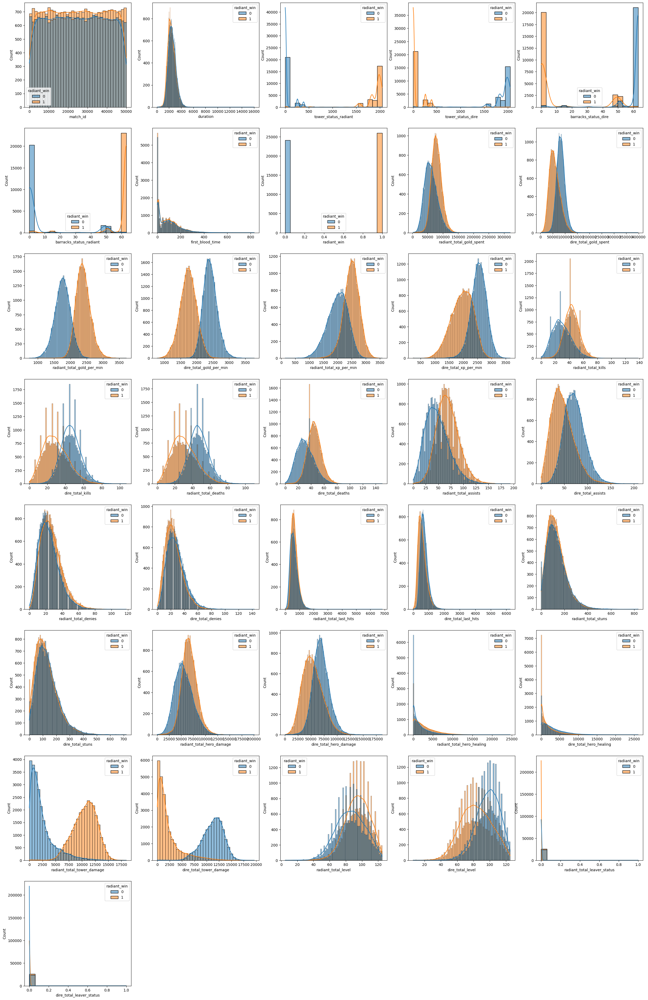

In [11]:
plotHistrogram(new_match_df, hue='radiant_win')

- remove duration outliers

100%|██████████| 36/36 [00:12<00:00,  2.91it/s]


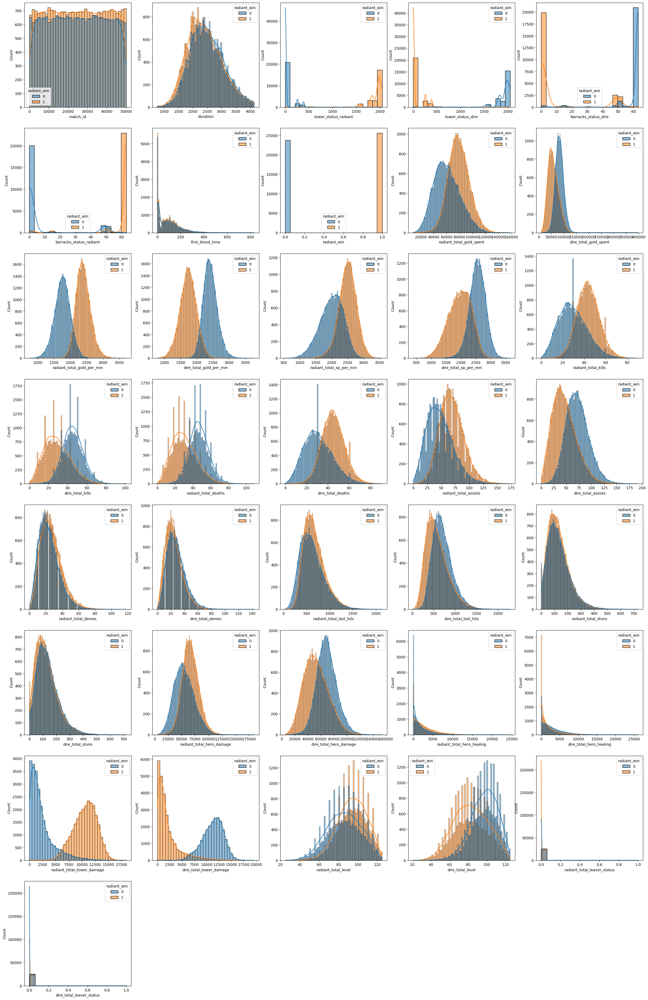

In [12]:
rm_outliers_match_df = removeNumericalOutlier(new_match_df, ['duration'])
plotHistrogram(rm_outliers_match_df, hue='radiant_win')

100%|██████████| 2/2 [00:00<00:00,  2.77it/s]


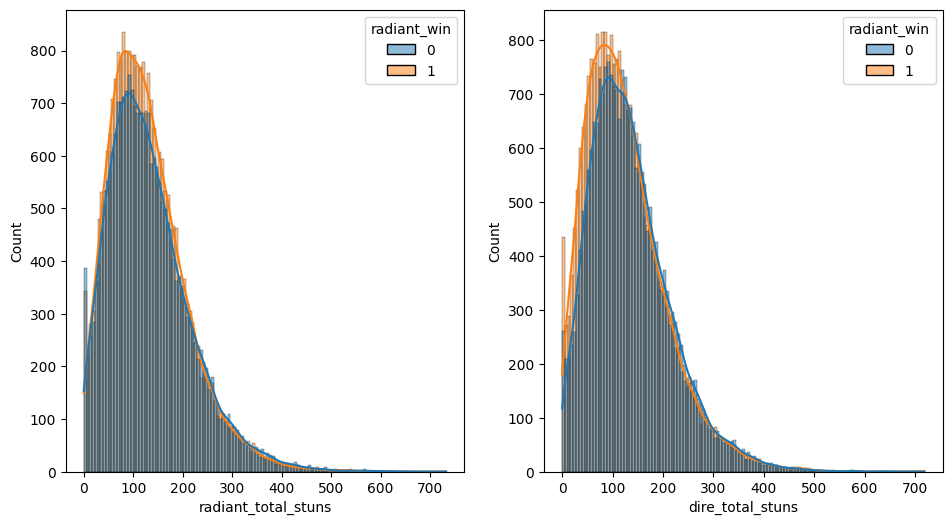

In [13]:
rm_outliers_match_df = removeNumericalOutlier(new_match_df, ['duration'])
cols = ['radiant_total_stuns', 'dire_total_stuns']
plot_cols = 6
plot_row = round((len(cols)/plot_cols)+1)
plot_num = 1
plt.figure(figsize=(plot_cols*6, plot_row*6))
for i in tqdm(cols):
    ax = plt.subplot(plot_row, plot_cols, plot_num)
    sns.histplot(data=rm_outliers_match_df, x=i, kde=True, hue='radiant_win')
    plot_num += 1
plt.show()

- scatter plot

> obviously see better sepration except stuns, LH, denies and assist

In [ ]:
plotScatter(rm_outliers_match_df.drop(['match_id', 'tower_status_radiant', 
                                        'tower_status_dire', 'barracks_status_dire', 
                                        'barracks_status_radiant'], axis=1), hue='radiant_win')

- does leaver status shown anything?

> <u>**ANS**</u> the data of abandoned matches is too less

100%|██████████| 35/35 [00:14<00:00,  2.47it/s]


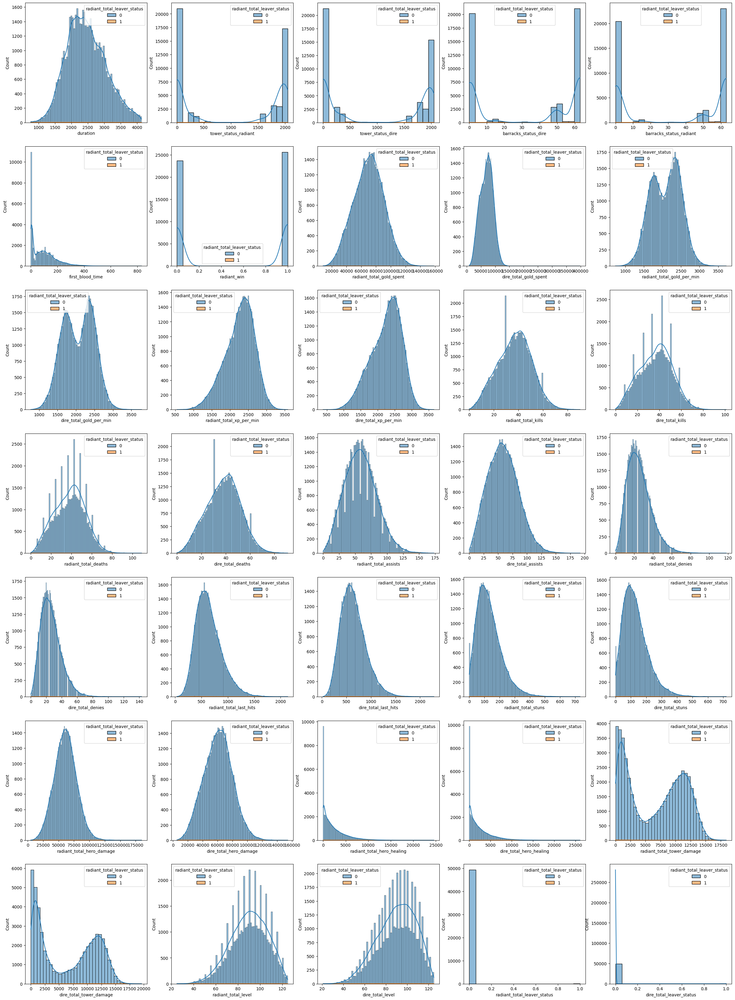

In [15]:
plotHistrogram(rm_outliers_match_df.drop(['match_id'], axis=1), 'radiant_total_leaver_status')

- cluster radiant and dire total stuns
    - ['radiant_total_stuns', 'dire_total_stuns']

> The cluster of stuns duration doesn't indicate any significant terms. But the clusters with high stuns duration will slightly increase gameplay time and it also affects the killing score

100%|██████████| 37/37 [00:11<00:00,  3.11it/s]


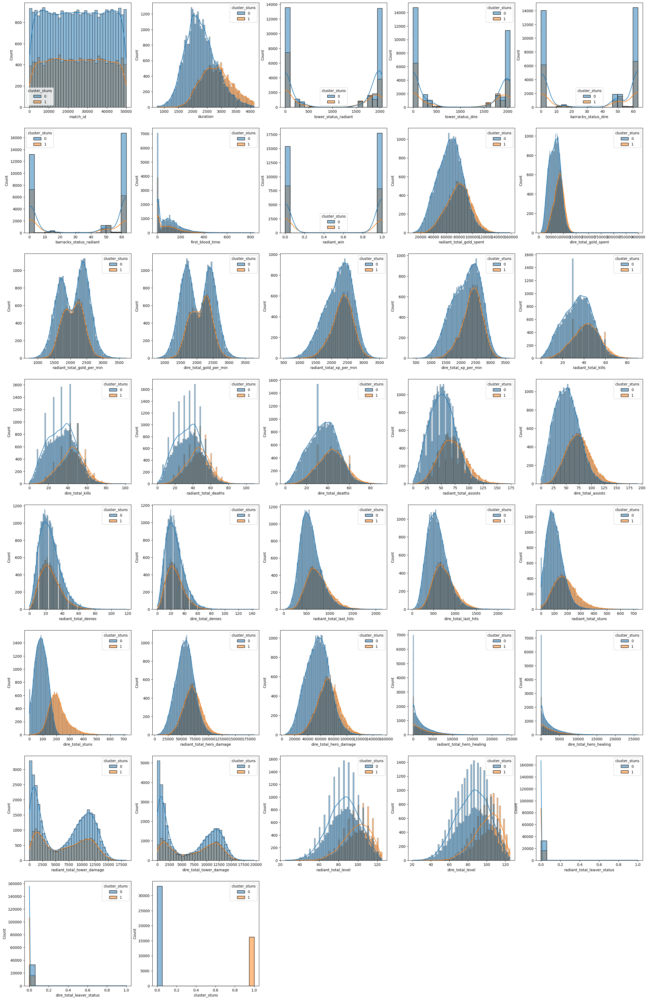

In [16]:
cluster_stuns = load('cluster_stuns.joblib')
new_match_df['cluster_stuns'] = cluster_stuns.labels_
rm_outliers_match_df = removeNumericalOutlier(new_match_df, ['duration'])
plotHistrogram(rm_outliers_match_df, hue='cluster_stuns')

##### explore teamfight data

In [17]:
team_stat_on_time = pd.read_csv("./new_dataframe/team_stat_on_time.csv", index_col=0)
new_teamfight_df = pd.read_csv("./new_dataframe/new_teamfight_df.csv", index_col=0)
##### calculate time before team fight and merge to team status on times
new_teamfight_df['time_before_fight'] = new_teamfight_df['start'] - new_teamfight_df['start']%60
new_teamfight_df = new_teamfight_df.drop(['start', 'end'], axis=1)
teamfight = new_teamfight_df.merge(team_stat_on_time, left_on=['match_id', 'time_before_fight'], right_on=['match_id', 'times'])
teamfight = teamfight.drop(['times'], axis=1)
teamfight['radiant_benefit'] = (teamfight['radiant_total_delta_gold'] + teamfight['radiant_total_delta_xp']) > (teamfight['dire_total_delta_gold'] + teamfight['dire_total_delta_xp'])
teamfight['radiant_benefit'] = teamfight['radiant_benefit'].replace([False, True], [0, 1])
teamfight.head()

,match_id,radiant_total_delta_gold,dire_total_delta_gold,radiant_total_delta_xp,dire_total_delta_xp,time_before_fight,radiant_gold_t_,dire_gold_t_,radiant_xp_t_,dire_xp_t_,radiant_lh_t_,dire_lh_t_,radiant_benefit
0,0,632,790,1027,812,180,3490,4057,3634,3543,23,40,1
1,0,1929,345,2436,1140,420,8544,9766,9060,8945,77,108,1
2,0,3145,-506,4553,289,900,23311,22604,24025,22787,243,282,1
3,0,1872,-112,2992,1022,1260,36570,32326,39106,31538,364,393,1
4,0,1768,2164,5096,5114,1560,47627,41332,52253,40816,470,466,0


In [18]:
teamfight.shape

(537768, 13)

- histogram plot

> We don't consider delta gold and XP because the benefit of a team fight calculate from delta gold and XP after the team fight occurs

> The histogram plot didn't show any feature that shows the team fight benefit but <font color=yellow>amazing that the gold and XP each team before the team fight doesn't affect to the benefit of that team fight</font>

> <font color=red>**Time before fight data have outliers**</font> if we remove the outliers of this feature will affect the outliers of other features


100%|██████████| 12/12 [00:54<00:00,  4.50s/it]


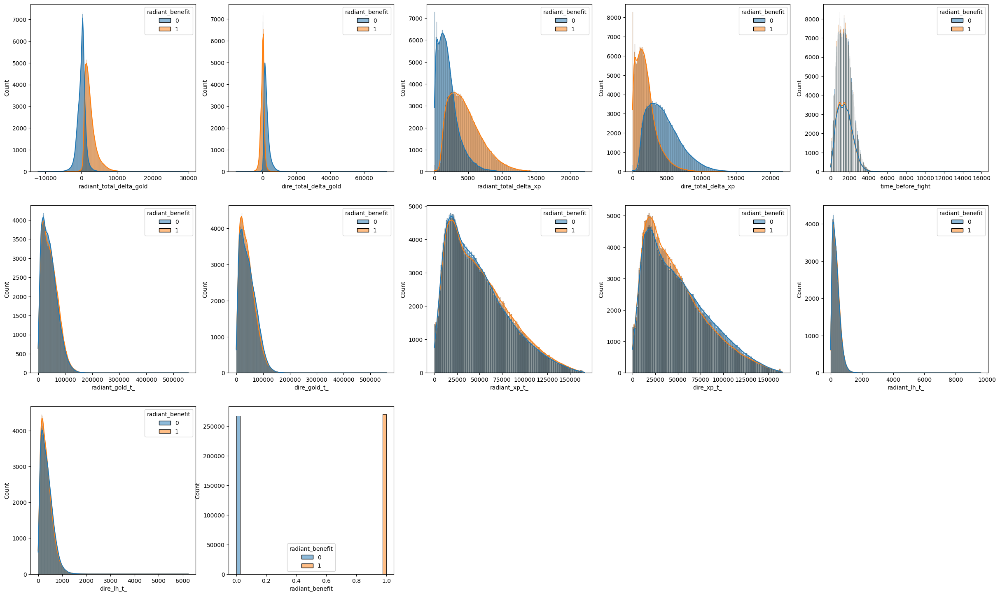

In [19]:
plotHistrogram(teamfight.drop(['match_id'], axis=1), hue='radiant_benefit')

- remove time before fight outliers

100%|██████████| 12/12 [00:40<00:00,  3.40s/it]


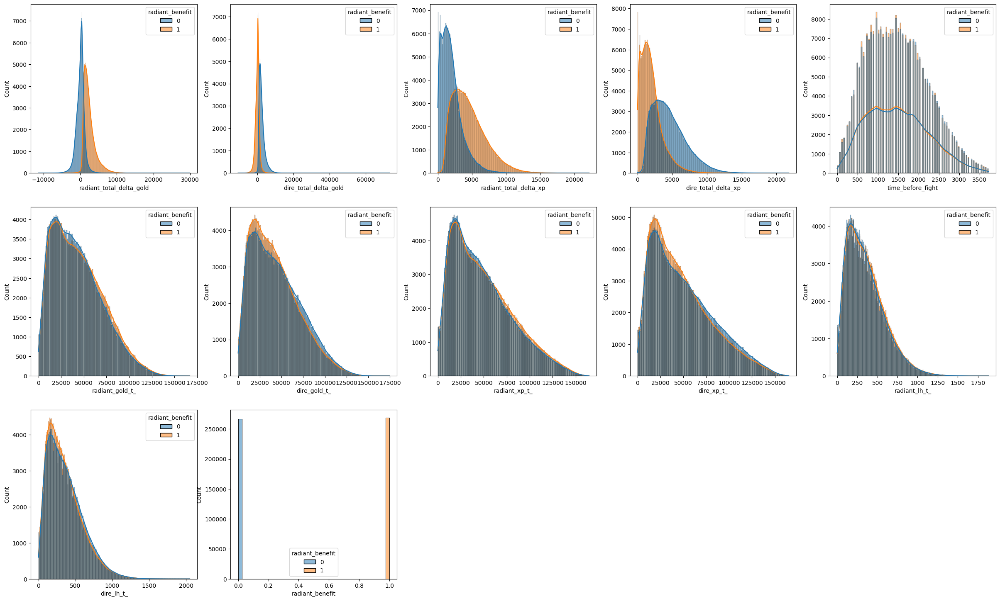

In [20]:
rm_outliers_teamfight_df = removeNumericalOutlier(teamfight, ['time_before_fight'])
plotHistrogram(rm_outliers_teamfight_df.drop(['match_id'], axis=1), hue='radiant_benefit')

- scatter plot

> the result is also the same as the histogram plot it doesn't have any feature that seems to impact on team fight benefit

In [ ]:
plotScatter(rm_outliers_teamfight_df.drop(['match_id'], axis=1), hue='radiant_benefit')

- cluster delta gold and XP
    - ['radiant_total_delta_gold', 'dire_total_delta_gold', 'radiant_total_delta_xp', 'dire_total_delta_xp']

> Cluster 1 is show the benefit in teamfight mean is 1036 and the team fight time in range 0 to 3720 with mean 1065

> Cluster 0 & 2 is show the benefit in teamfight that more higher and lower than cluster 1 and the team fight time in range 420 to 3720 with mean 1966

> Those cluster show the team gold, XP, LH score are dependent on time before fight and it also effect to benefit in team fight but not the significant terms for predict team fight win and lose

100%|██████████| 14/14 [00:48<00:00,  3.49s/it]


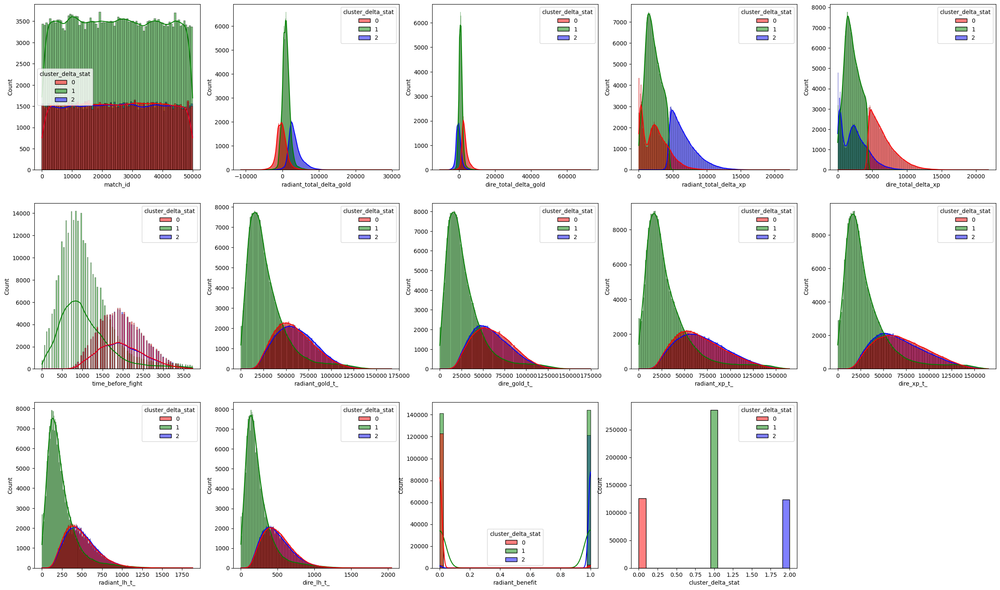

In [21]:
cluster_delta_stat = load('cluster_delta_stat.joblib')
teamfight['cluster_delta_stat'] = cluster_delta_stat.labels_
rm_outliers_teamfight_df = removeNumericalOutlier(teamfight, ['time_before_fight'])
plotHistrogram(rm_outliers_teamfight_df, hue='cluster_delta_stat', palette=['r', 'g', 'b'])

- cluster team stat
    - ['radiant_gold_t_', 'dire_gold_t_', 'radiant_xp_t_', 'dire_xp_t_', 'radiant_lh_t_', 'dire_lh_t_']

> The result is also the same as the delta gold and XP cluster it shows 2 clusters that are different on time before the team fight

##### explore player statistic in match

In [22]:
player_df = pd.read_csv('players.csv')
player_df = player_df.iloc[:, 0:25]
player_df = player_df.drop(['gold', 'account_id', 'item_0', 'item_1', 'item_2', 'item_3', 'item_4', 'item_5'], axis=1)
player_df['stuns'] = player_df['stuns'].replace(['None'], [0.0])
player_df['stuns'] = player_df['stuns'].astype(np.float64)
# player_df['leaver_status'] = player_df['leaver_status'].replace(list(range(5)), [0, 0, 1, 1, 1])
player_df.head()

,match_id,hero_id,player_slot,gold_spent,gold_per_min,xp_per_min,kills,deaths,assists,denies,last_hits,stuns,hero_damage,hero_healing,tower_damage,level,leaver_status
0,0,86,0,10960,347,362,9,3,18,1,30,76.7356,8690,218,143,16,0
1,0,51,1,17760,494,659,13,3,18,9,109,87.4164,23747,0,423,22,0
2,0,83,2,12195,350,385,0,4,15,1,58,0.0000,4217,1595,399,17,0
3,0,11,3,22505,599,605,8,4,19,6,271,0.0000,14832,2714,6055,21,0
4,0,67,4,23825,613,762,20,3,17,13,245,0.0000,33740,243,1833,24,0


- cluster player score
    - ['gold_spent', 'gold_per_min', 'xp_per_min', 'kills', 'deaths', 'assists', 'denies', 'last_hits', 'stuns', 'hero_damage', 'hero_healing', 'tower_damage']

> cluster 0 show the lower statistic and we guess it should be the support hero

> cluster 1 show the better score, damage and gold spent we guess that is the carry or farming hero type

100%|██████████| 18/18 [01:09<00:00,  3.84s/it]


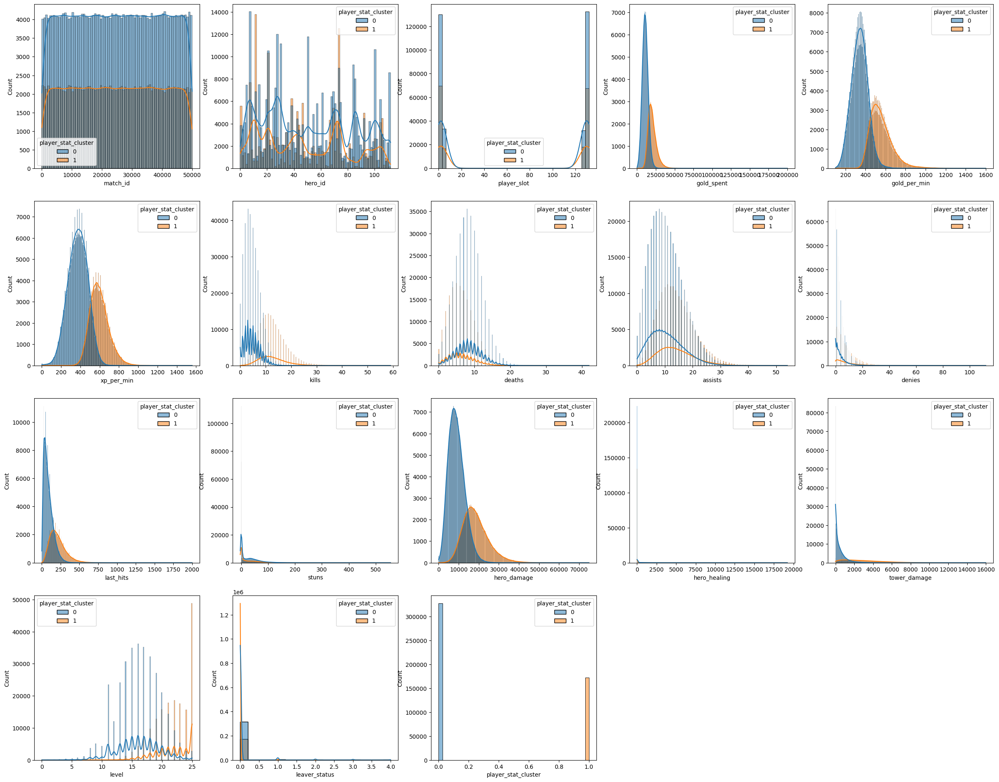

In [23]:
player_stat_cluster = load('player_stat_cluster.joblib')
player_df['player_stat_cluster'] = player_stat_cluster.labels_
plotHistrogram(player_df, hue='player_stat_cluster')

In [24]:
hero_name = pd.read_csv('hero_names.csv')
hero_name['hero_id'] = hero_name['hero_id']
hero_lookup_table = dict(zip(hero_name['hero_id'],hero_name['localized_name']))
hero_lookup_table[0] = 'missing'
player_df['hero_name'] = player_df['hero_id'].apply(lambda id : hero_lookup_table[id])
print(player_df.loc[player_df['player_stat_cluster']==1]['hero_name'].value_counts())
print(player_df.loc[player_df['player_stat_cluster']==0]['hero_name'].value_counts())

Shadow Fiend        12092
Windranger          10340
Alchemist            6492
Juggernaut           6414
Invoker              6047
                    ...  
Dazzle                 44
Oracle                 40
Io                     39
Treant Protector       30
Chen                   24
Name: hero_name, Length: 110, dtype: int64
Windranger     10541
Earthshaker    10040
Slardar         8848
Dazzle          8359
Rubick          8017
               ...  
Terrorblade      632
Chen             555
Lone Druid       535
Lycan            464
missing           37
Name: hero_name, Length: 111, dtype: int64


- answer the assumtion

> cluster 1 shows the carry hero and the top 5 heroes of this cluster is Shadow Fiend, Windranger, Alchemist, Juggernaut, Invoker

> cluster 0 show the other roles hero the top 5 heroes of this cluster is Windranger, Earthshaker, Slardar, Dazzle, Rubick

- what's the most pick hero

> <u>**ANS**</u> Windranger, Shadow Fiend, Invoker, Earthshaker, Slardar

### Data Preproceesing

In [25]:
def Scale(df:pd.DataFrame):
    Scaler = MinMaxScaler()
    scaled_df = Scaler.fit_transform(df)
    scaled_df = pd.DataFrame(df, columns= df.columns)
    return scaled_df

def Skew(df : pd.DataFrame):
    fea_df = df.iloc[:, :-1]
    target_df = df.iloc[:, -1]
    quantile = QuantileTransformer(n_quantiles=100, output_distribution='normal')
    data_trans = quantile.fit_transform(fea_df)
    target_df = target_df.reset_index(drop = True)
    skewed_df = pd.DataFrame(data_trans, columns= fea_df.columns)
    skewed_df = pd.concat([skewed_df, target_df], axis = 1)
    return skewed_df

### Model Construction

In [26]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix ,classification_report ,plot_confusion_matrix
from sklearn.preprocessing import QuantileTransformer, quantile_transform

def Logistic(df:pd.DataFrame):
    x = df.iloc[:, :-1]
    y = df.iloc[:, -1]
    col = df.columns
    weight = []
    x_train ,x_test ,y_train ,y_test = train_test_split(x,y,test_size=0.2,random_state = 1)
    clf = LogisticRegression()
    clf = clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test)
    for i in clf.coef_:
        for j in i:
            weight.append(j)

    y_proba_pred = clf.predict_proba(x_test)
    weight_df = pd.DataFrame(weight, columns= ['weight'])
    column = pd.DataFrame(x.columns, columns= ['column'])
    df_ = pd.concat([column, weight_df], axis= 1)
    prob = pd.DataFrame(np.max(y_proba_pred, axis=1), columns=['probability'])
    # print(col)

    
    print("Classification report \n=======================")
    print(classification_report(y_true=y_test, y_pred=y_pred))
    print("Confusion matrix \n=======================")
    print(confusion_matrix(y_true=y_test, y_pred=y_pred))
    print('Accuracy of trainning set:{:.2f}'.format(clf.score(x_train, y_train)))
    print('Accuracy of testing set:{:.2f}'.format(clf.score(x_test, y_test)))

    return df_,y_pred, x_test, y_test,prob

#### Experiment

- EXP : Train logistic regression model with good features to predict if radaint team is win or not
    - radiant_total_gold_per_min
    - dire_total_gold_per_min
    - radiant_total_xp_per_min
    - dire_total_xp_per_min
    - radiant_total_last_hits
    - dire_total_last_hits







In [27]:
#####
new_match_df = pd.read_csv("./new_dataframe/new_match_df.csv", index_col=0)
new_match_df['radiant_total_leaver_status'] = new_match_df['radiant_total_leaver_status'].replace(list(range(10)), [0, 0, 1, 1, 1, 1, 1, 1, 1, 1])
new_match_df['dire_total_leaver_status'] = new_match_df['dire_total_leaver_status'].replace(list(range(10)), [0, 0, 1, 1, 1, 1, 1, 1, 1, 1])
new_match_df.head()
match1 = new_match_df.copy()
radiant_win_col = match1.loc[:, 'radiant_win']
match1 = match1.drop(columns = ['radiant_total_leaver_status', 'dire_total_leaver_status', 'radiant_win', 'dire_total_tower_damage', 'radiant_total_tower_damage'])
match1 = pd.concat([match1, radiant_win_col], axis= 1)
fea_select_df = match1.copy()
fea_select_df = fea_select_df.drop(columns= ['match_id', 'tower_status_radiant', 'tower_status_dire', 'barracks_status_dire', 'barracks_status_radiant'])
fea_RMOutlier = removeNumericalOutlier(fea_select_df, ['duration'])
skewed_df = Skew(fea_RMOutlier)
scaled_df = Scale(skewed_df)
weight_df, y_pred, x_test, y_test, prob = Logistic(scaled_df)
best1_fea = scaled_df.loc[:, weight_df.sort_values(by= ['weight'], ascending= False).iloc[0:3, 0]]
best2_fea = scaled_df.loc[:, weight_df.sort_values(by= ['weight'], ascending= False).iloc[-3:, 0]]
best_fea = pd.concat([best1_fea, best2_fea, scaled_df.iloc[:, -1]], axis = 1)
weight_high_fea, y_pred, x_test, y_test, prob = Logistic(best_fea)
print(weight_df.sort_values(by= ['weight'], ascending= False))

Classification report 
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      4774
           1       0.99      0.99      0.99      5097

    accuracy                           0.99      9871
   macro avg       0.99      0.99      0.99      9871
weighted avg       0.99      0.99      0.99      9871

Confusion matrix 
[[4724   50]
 [  53 5044]]
Accuracy of trainning set:0.99
Accuracy of testing set:0.99
Classification report 
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      4774
           1       0.99      0.99      0.99      5097

    accuracy                           0.99      9871
   macro avg       0.99      0.99      0.99      9871
weighted avg       0.99      0.99      0.99      9871

Confusion matrix 
[[4730   44]
 [  55 5042]]
Accuracy of trainning set:0.99
Accuracy of testing set:0.99
                        column    weight
4   radiant_total_gold_per_min  7.714174
17      

- Visualize the prediction result
    -   3 represent the false prediction of class o
    -   4 represent the false prediction of class 1

100%|██████████| 7/7 [00:02<00:00,  2.69it/s]


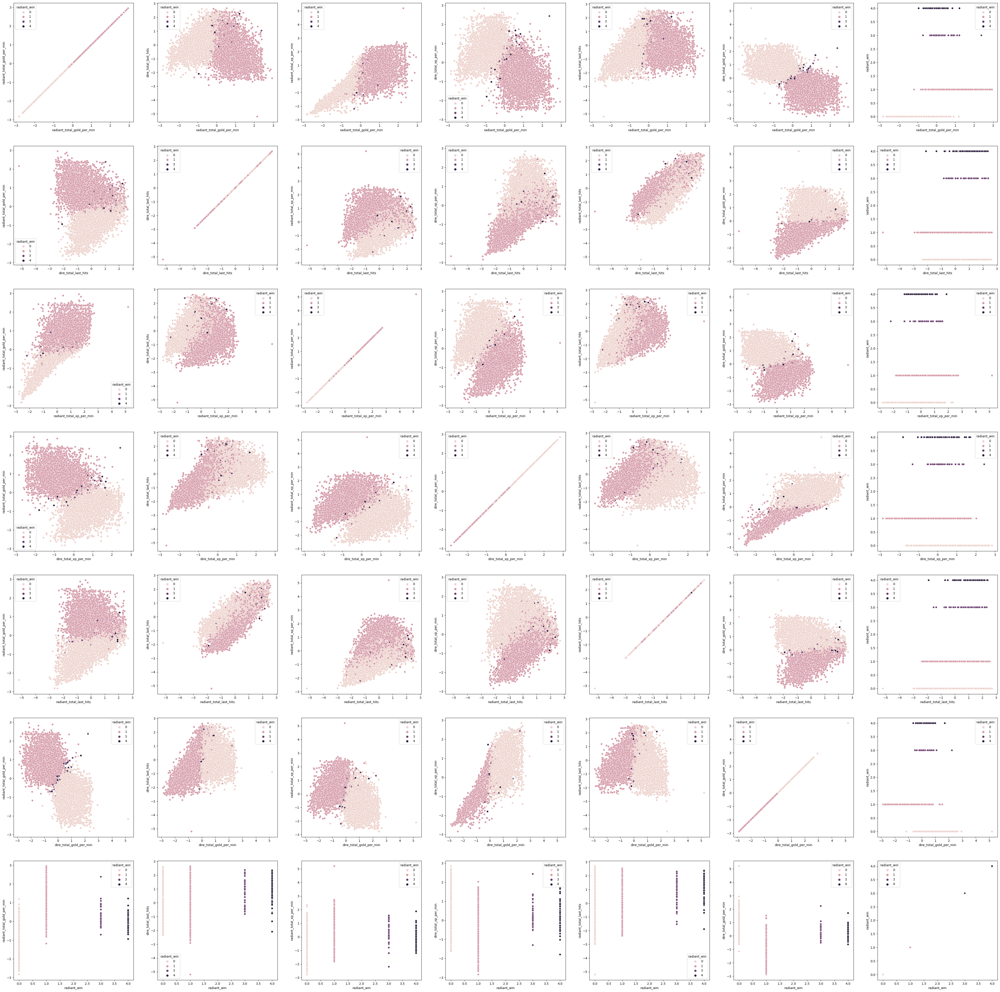

In [28]:
x_test = x_test.reset_index(drop = True)
y_test = y_test.reset_index(drop = True)
ground_truth = pd.concat([x_test, y_test], axis= 1)
model_predict = pd.DataFrame(y_pred, columns = ['model_predict'])
model_predict = pd.concat([ground_truth, model_predict, prob], axis= 1)
wrong_pred_row = model_predict[(model_predict['radiant_win'] != model_predict['model_predict'])]
test_wrong_pred = model_predict.copy()

for i in wrong_pred_row.index: 
        if test_wrong_pred.loc[i,'radiant_win'] == 0:
               test_wrong_pred.loc[i,'radiant_win'] = 3 #if it perdicted as 1 but actually is 0  turn to 3
        else:
                test_wrong_pred.loc[i,'radiant_win']=4

plotScatter(test_wrong_pred.drop(['model_predict','probability'], axis = 1), hue='radiant_win' )

#### Probability Function Visualization 

- Visualize the fasle predicted data that got probability point less than 0.8

100%|██████████| 7/7 [00:02<00:00,  2.66it/s]


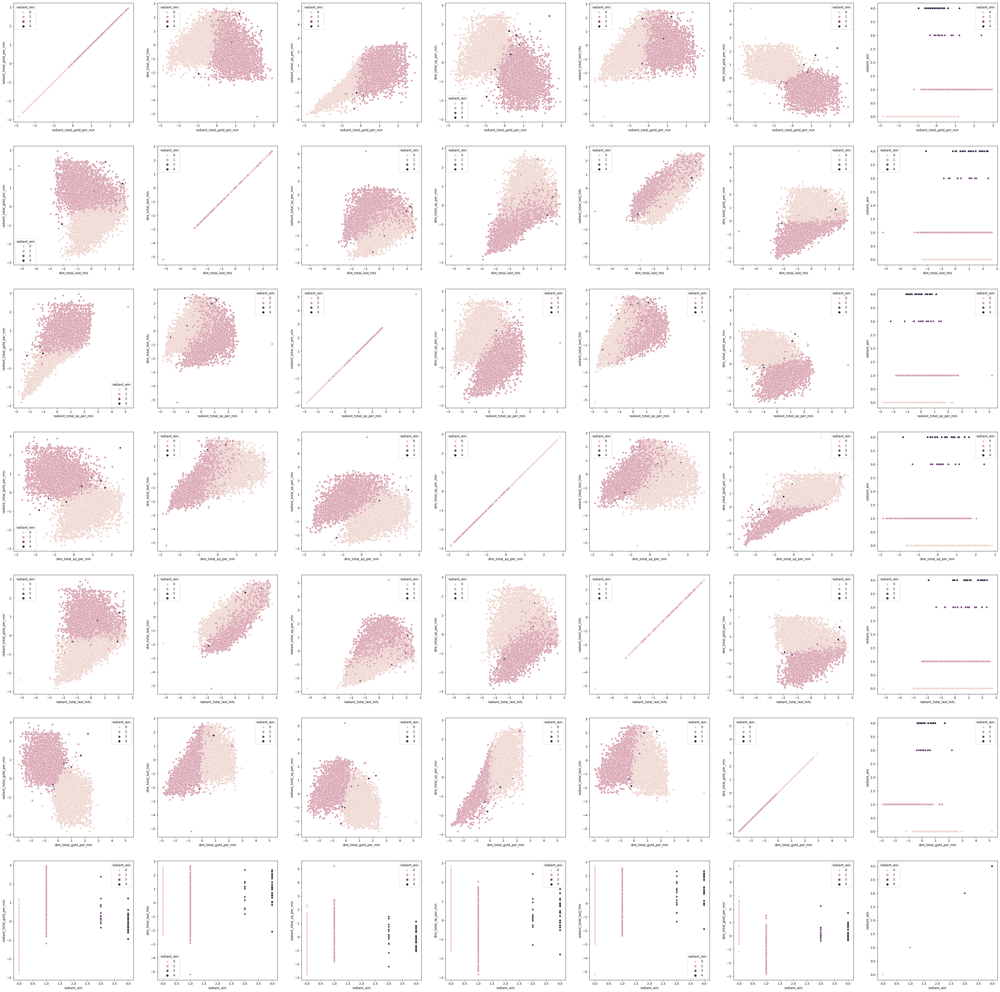

In [29]:
too_confident = wrong_pred_row[(wrong_pred_row['probability'] >= 0.8)]
too_confident_df = model_predict.copy()
for i in too_confident.index: 
        if too_confident_df.loc[i,'radiant_win'] == 0:
               too_confident_df.loc[i,'radiant_win'] = 3 #if it perdicted as 1 but actually is 0  turn to 3
        else:
                too_confident_df.loc[i,'radiant_win']=4


plotScatter(too_confident_df.drop(['model_predict','probability'], axis = 1), hue='radiant_win' )

- Visualize the fasle predicted data that got probability point less than 0.8

100%|██████████| 7/7 [00:05<00:00,  1.21it/s]


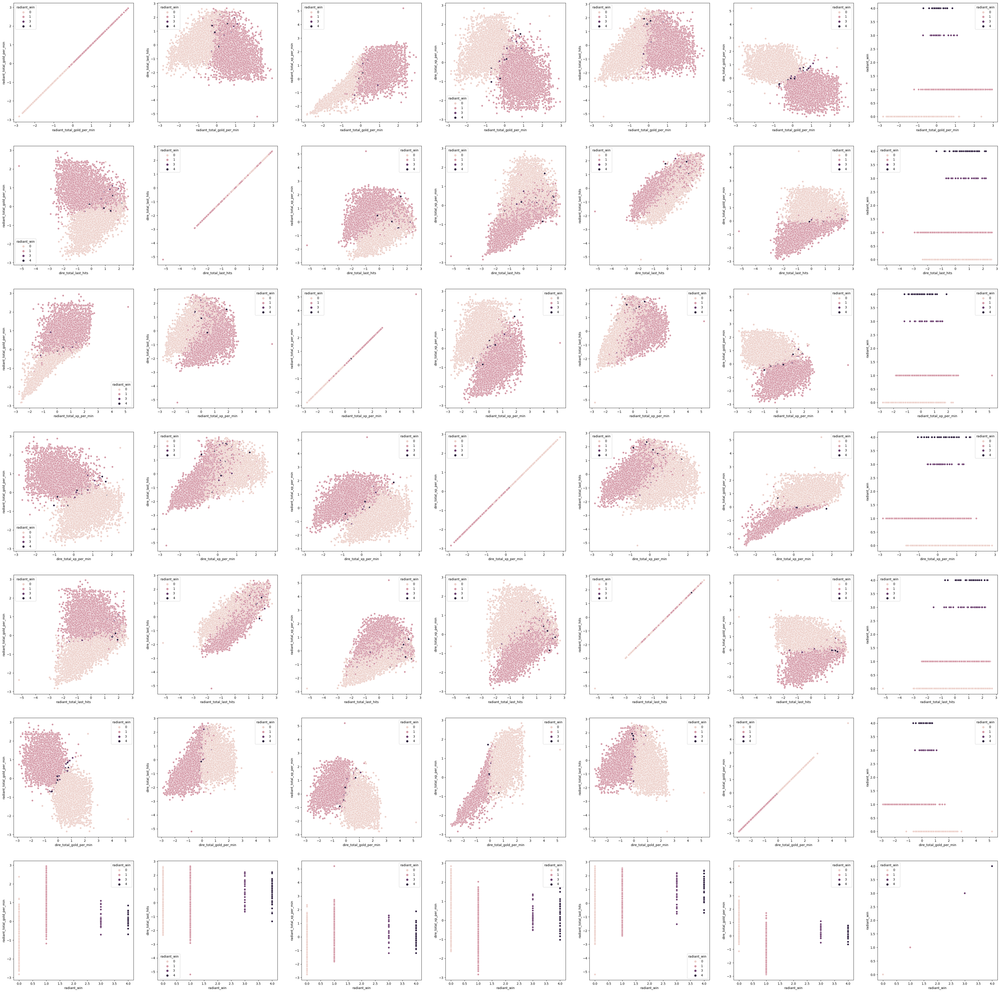

In [30]:
not_too_confident = wrong_pred_row[(wrong_pred_row['probability'] <= 0.8)]
not_too_confident_df = model_predict.copy()
for i in not_too_confident.index: 
        if not_too_confident_df.loc[i,'radiant_win'] == 0:
               not_too_confident_df.loc[i,'radiant_win'] = 3 #if it perdicted as 1 but actually is 0  turn to 3
        else:
                not_too_confident_df.loc[i,'radiant_win']=4

plotScatter(not_too_confident_df.drop(['model_predict','probability'], axis = 1), hue='radiant_win' )

- Result Analysis 
    - the data that got false predictions is outlier and causing the model to get wrong prediction as we can see from the visualization that the false predicted data are seem to be the classes that got mixed up in other class or near the class boarder
    